<a href="https://colab.research.google.com/github/mamta691/Flask_app_a/blob/main/flight_price_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <font color='blue'> Flight Price Prediction </font>
###  The aim of the study is to analyse this flight booking dataset in attempt to answer these research questions
-  a) Does price vary with Airlines?
-  b) How is the price affected when tickets are bought in just 1 or 2 days before departure?
-  c) Does ticket price change based on the departure time and arrival time?
-  d) How the price changes with change in Source and Destination?
-  e) How does the ticket price vary between Economy and Business class?

    https://www.kaggle.com/datasets/shubhambathwal/flight-price-prediction
#### this research presented by :
#  <font color='red'> Mohamed Anwar </font>


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import os
os.chdir('C:\\Users\\Anwar\\Desktop')


### reading dataset

In [ ]:
df_init = pd.read_csv("Clean_Dataset.csv",sep=",", encoding="utf-8")
df_init


,Unnamed: 0,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956
3,3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955
4,4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955
...,...,...,...,...,...,...,...,...,...,...,...,...
300148,300148,Vistara,UK-822,Chennai,Morning,one,Evening,Hyderabad,Business,10.08,49,69265
300149,300149,Vistara,UK-826,Chennai,Afternoon,one,Night,Hyderabad,Business,10.42,49,77105
300150,300150,Vistara,UK-832,Chennai,Early_Morning,one,Night,Hyderabad,Business,13.83,49,79099
300151,300151,Vistara,UK-828,Chennai,Early_Morning,one,Evening,Hyderabad,Business,10.00,49,81585


### Exploring the dataset

In [ ]:
df_init.info()

<class 'pandas.core.frame.DataFrame'>

RangeIndex: 300153 entries, 0 to 300152

Data columns (total 12 columns):

 #   Column            Non-Null Count   Dtype  

---  ------            --------------   -----  

 0   Unnamed: 0        300153 non-null  int64  

 1   airline           300153 non-null  object 

 2   flight            300153 non-null  object 

 3   source_city       300153 non-null  object 

 4   departure_time    300153 non-null  object 

 5   stops             300153 non-null  object 

 6   arrival_time      300153 non-null  object 

 7   destination_city  300153 non-null  object 

 8   class             300153 non-null  object 

 9   duration          300153 non-null  float64

 10  days_left         300153 non-null  int64  

 11  price             300153 non-null  int64  

dtypes: float64(1), int64(3), object(8)

memory usage: 27.5+ MB


In [ ]:
df=df_init.drop(['Unnamed: 0'],axis=1)
df             # removing column unnamed

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956
3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955
4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955
...,...,...,...,...,...,...,...,...,...,...,...
300148,Vistara,UK-822,Chennai,Morning,one,Evening,Hyderabad,Business,10.08,49,69265
300149,Vistara,UK-826,Chennai,Afternoon,one,Night,Hyderabad,Business,10.42,49,77105
300150,Vistara,UK-832,Chennai,Early_Morning,one,Night,Hyderabad,Business,13.83,49,79099
300151,Vistara,UK-828,Chennai,Early_Morning,one,Evening,Hyderabad,Business,10.00,49,81585


In [ ]:
df.describe()

,duration,days_left,price
count,300153.000000,300153.000000,300153.000000
mean,12.221021,26.004751,20889.660523
std,7.191997,13.561004,22697.767366
min,0.830000,1.000000,1105.000000
25%,6.830000,15.000000,4783.000000
50%,11.250000,26.000000,7425.000000
75%,16.170000,38.000000,42521.000000
max,49.830000,49.000000,123071.000000


In [ ]:
df.isnull().sum() # checking if we have null values

airline             0
flight              0
source_city         0
departure_time      0
stops               0
arrival_time        0
destination_city    0
class               0
duration            0
days_left           0
price               0
dtype: int64

In [ ]:
df['departure_time'].value_counts()

Morning          71146
Early_Morning    66790
Evening          65102
Night            48015
Afternoon        47794
Late_Night        1306
Name: departure_time, dtype: int64

#### Most flights leave in the morning , less flights leave late at night.

In [ ]:
df['airline'].value_counts()

Vistara      127859
Air_India     80892
Indigo        43120
GO_FIRST      23173
AirAsia       16098
SpiceJet       9011
Name: airline, dtype: int64

#### Vistara Airline is the most used, SpiceJet is the least

<AxesSubplot:xlabel='price', ylabel='Count'>

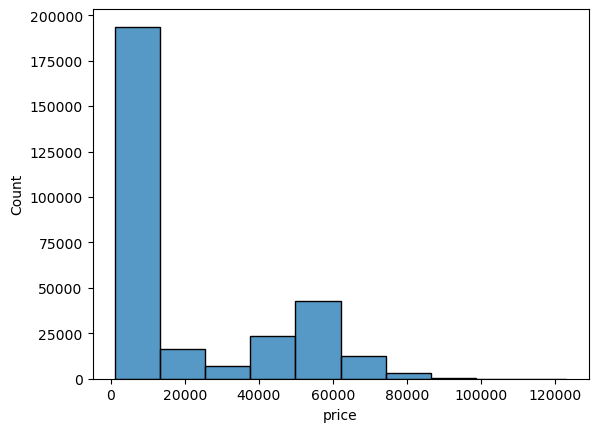

In [ ]:
sns.histplot(df['price'],bins=10)

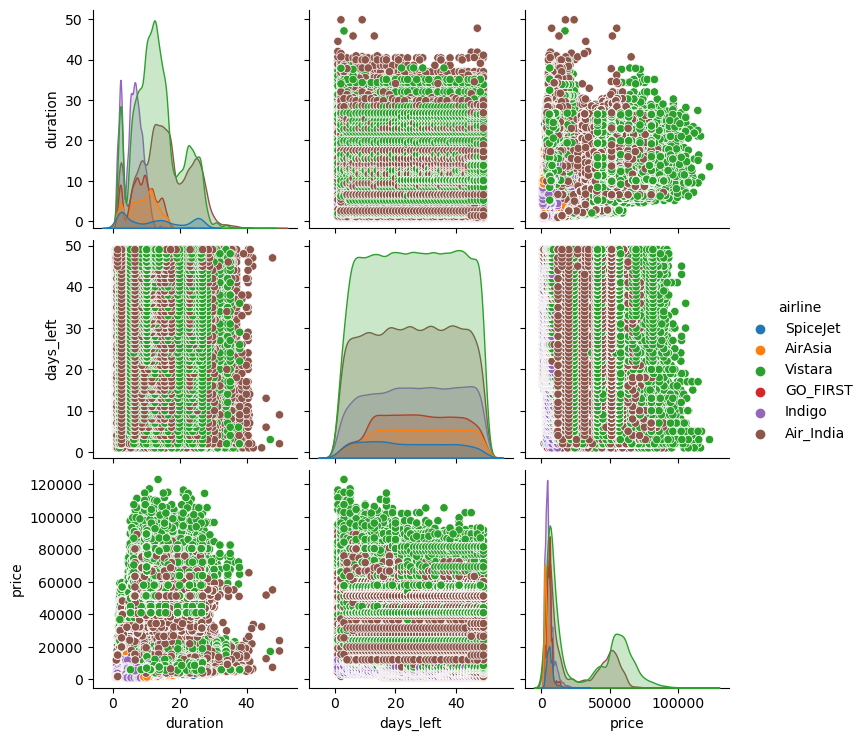

In [ ]:
sns.pairplot(df,hue="airline") # diagonal= distribution for the feature itself

Text(0.5, 1.0, 'price vs duration')

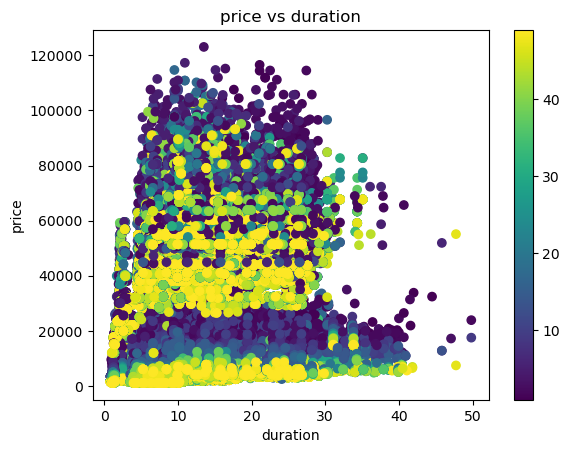

In [ ]:
plt.scatter(df['duration'] , df['price'] , c= df['days_left'])
plt.colorbar()
plt.xlabel("duration")
plt.ylabel("price")
plt.title("price vs duration")

In [ ]:
import plotly.express as px
fig = px.scatter(df, x="price", y="days_left", color="stops",
                 size='duration')
fig.show()

<AxesSubplot:ylabel='airline'>

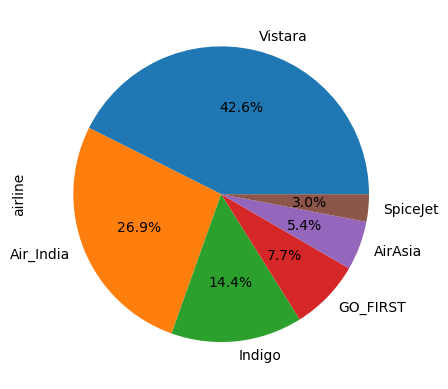

In [ ]:
round(df['airline'].value_counts()/df.shape[0]*100,2).plot.pie(autopct = "%1.1f%%")

<AxesSubplot:ylabel='departure_time'>

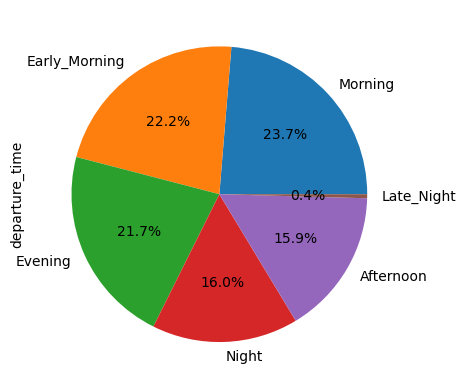

In [ ]:
round(df['departure_time'].value_counts()/df.shape[0]*100,2).plot.pie(autopct = "%1.1f%%")

<AxesSubplot:>

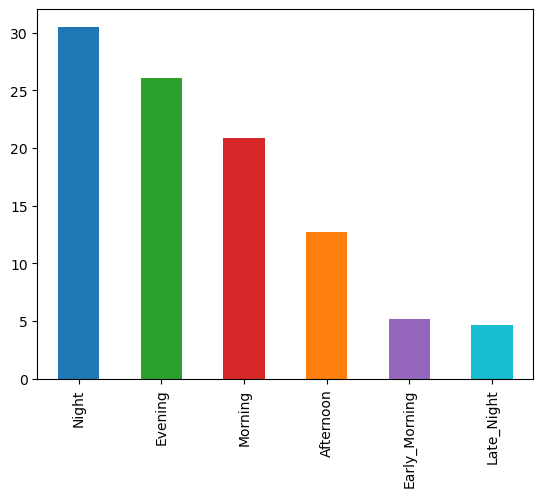

In [ ]:
round(df['arrival_time'].value_counts()/df.shape[0]*100,2).plot.bar(color = ["#1f77b4", "#2ca02c", "#d62728", "#ff7f0e", "#9467bd", "#17becf"]
)

In [ ]:
fig = px.pie(df, names='airline')
fig.show()

### a) Does price vary with Airlines?

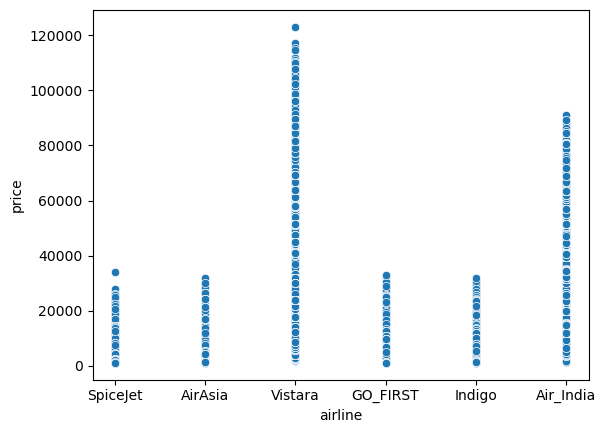

In [ ]:
# presenting the relationship between price and the type of airline to see
# whether the price varies with airlines or not
sns.scatterplot(x='airline', y='price', data=df)
plt.show()

#### from the above chart , it's clear that the price does vary with airlines , Vistara airline flights  are very expensive , Air India is a little bit expensive , SpiceJet , AirAsia, Go_first and Indigo airlines almost have equal prices. but this approach might not be the best , because we have different factors that could affect the price as duration , stops , departure and arrival time , so vitara flights might just be longer? that's why it takes more money? we want to make sure that it has high price because it's expensive for the services it provides, not for any other factors that affect all airlines.

## BUT ,what is the most expensive airline?

In [ ]:
df['duration'].value_counts()

2.17     4242
2.25     4036
2.75     2879
2.08     2755
2.83     2323
         ... 
37.17       1
38.75       1
38.50       1
36.25       1
41.50       1
Name: duration, Length: 476, dtype: int64

In [ ]:
df['duration_group'] = pd.cut(df['duration'], bins=[0, 2, 4, 6, 8, float('inf')], labels=['0-2', '2-4', '4-6', '6-8', '8+'])
df['stops_group'] = df['stops'].replace({'zero': '0', 'one': '1', 'two_or_more': '2+'})
df['days_left_group'] = pd.cut(df['days_left'], bins=[-1, 1, 2, 3, 4, float('inf')], labels=['0-1', '1-2', '2-3', '3-4', '4+'])
grouped = df.groupby(['duration_group', 'stops_group', 'days_left_group', 'airline'])['price'].mean().reset_index()
grouped

,duration_group,stops_group,days_left_group,airline,price
0,0-2,0,0-1,AirAsia,7564.600000
1,0-2,0,0-1,Air_India,13425.200000
2,0-2,0,0-1,GO_FIRST,7036.714286
3,0-2,0,0-1,Indigo,10576.478261
4,0-2,0,0-1,SpiceJet,14238.000000
...,...,...,...,...,...
445,8+,2+,4+,Air_India,13238.443343
446,8+,2+,4+,GO_FIRST,7289.086154
447,8+,2+,4+,Indigo,6953.612293
448,8+,2+,4+,SpiceJet,NaN


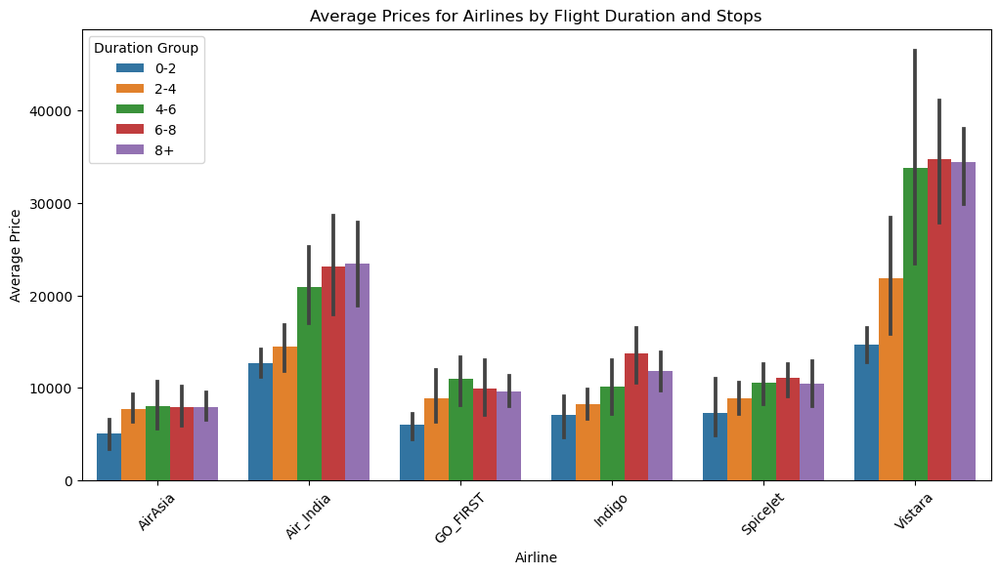

In [ ]:
plt.figure(figsize=(12, 6))
sns.barplot(x='airline', y='price', hue='duration_group', data=grouped)
plt.xlabel('Airline')
plt.ylabel('Average Price')
plt.title('Average Prices for Airlines by Flight Duration and Stops')
plt.xticks(rotation=45)
plt.legend(title='Duration Group')
plt.show()



### I considered only 3 factors that affect the price :stops , duration and days_left . from the graph above we get that Vistara is indeed the most expensive airline .

In [ ]:
df[['days_left','price']]


,days_left,price
0,1,5953
1,1,5953
2,1,5956
3,1,5955
4,1,5955
...,...,...
300148,49,69265
300149,49,77105
300150,49,79099
300151,49,81585


### b) How is the price affected when tickets are bought in just 1 or 2 days before departure?

#### Days Left Column: this is calculated by subtracting the trip date by the booking date, hence we can use it to see how the price is affected for tickets are bought in just 1 or 2 days before departure?

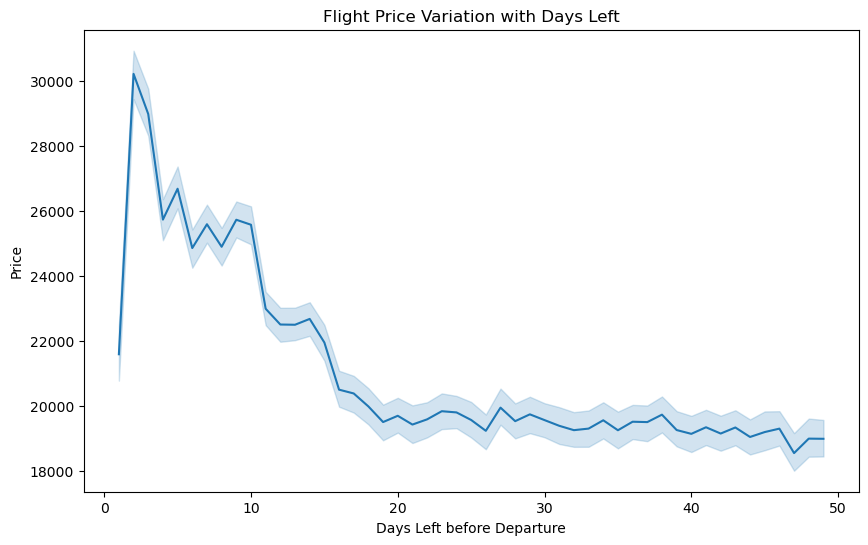

In [ ]:
plt.figure(figsize=(10, 6))
sns.lineplot(x="days_left", y="price", data=df)
plt.xlabel("Days Left before Departure")
plt.ylabel("Price")
plt.title("Flight Price Variation with Days Left")
plt.show()


#### the above graph shows that flights of long days left before departure the price is cheaper than flights that have departure of 1 or two days .

In [ ]:
df[['days_left','price']].tail(100)

,days_left,price
300053,47,51345
300054,47,51345
300055,47,51345
300056,47,51345
300057,47,51345
...,...,...
300148,49,69265
300149,49,77105
300150,49,79099
300151,49,81585


In [ ]:
df['days_left'].value_counts()

25    6633
18    6602
39    6593
32    6585
26    6573
24    6542
19    6537
31    6534
33    6532
40    6531
41    6525
28    6522
38    6512
20    6502
30    6501
42    6497
22    6494
36    6490
21    6479
37    6476
43    6472
44    6436
17    6419
11    6417
34    6412
13    6404
23    6401
29    6397
12    6381
27    6360
14    6349
15    6340
45    6314
35    6291
16    6272
46    6160
49    6154
48    6078
47    6069
10    5822
8     5767
6     5740
7     5703
9     5665
5     5392
4     5077
3     4248
2     4026
1     1927
Name: days_left, dtype: int64

In [ ]:
compare1 = df[df['days_left'] <=2 ]
compare1['price'].mean()

27421.169326390056

In [ ]:
compare2 = df[df['days_left'] >47 ]
compare2['price'].mean()

18995.533355134074

#### from the above results , and the graph , we get that flights are more expensive when bought in 1 or 2 days before departure .

### c) Does ticket price change based on the departure time and arrival time?

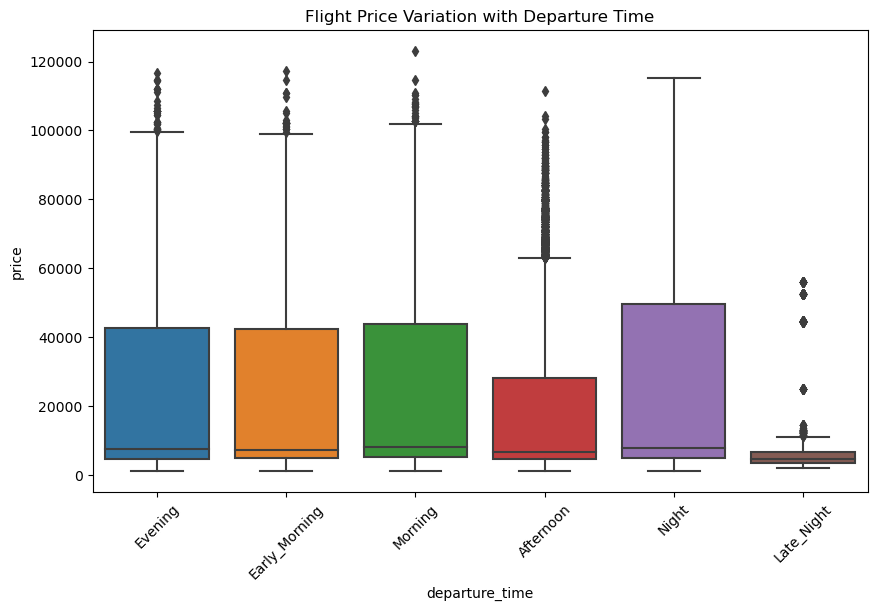

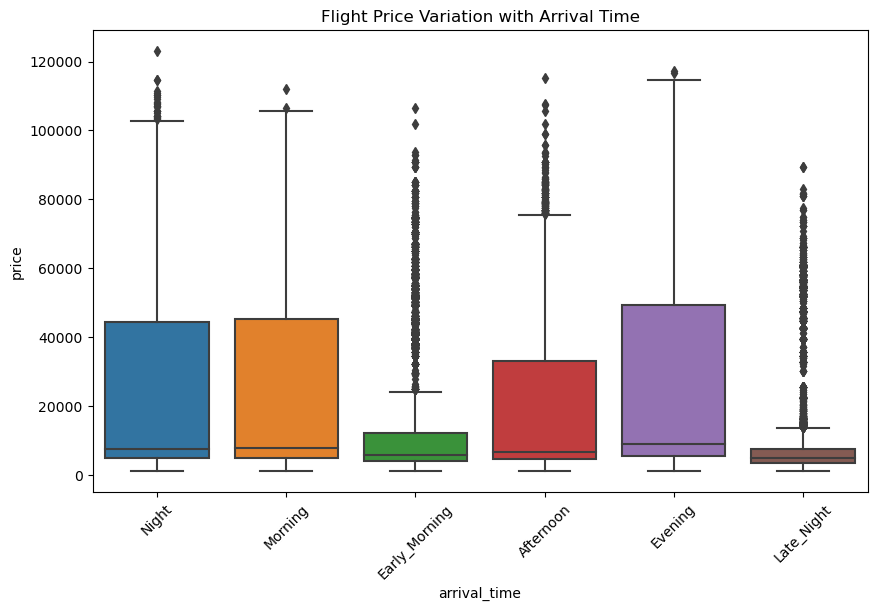

In [ ]:
plt.figure(figsize=(10, 6))
sns.boxplot(x="departure_time", y="price", data=df)
plt.xlabel("departure_time")
plt.ylabel("price")
plt.title("Flight Price Variation with Departure Time")
plt.xticks(rotation=45)
plt.show()

plt.figure(figsize=(10, 6))
sns.boxplot(x="arrival_time", y="price", data=df)
plt.xlabel("arrival_time")
plt.ylabel("price")
plt.title("Flight Price Variation with Arrival Time")
plt.xticks(rotation=45)
plt.show()


#### from the above two graphs , we get that the price of flights does vary with departure and arrival time , for departure time , it's a little bit more expensive at night , but it's almost the same prices for evening , morning and early morning , less price for flights that take off in the afternoon , and the cheapest flights take off late at night , the above graphs also indicates data has some outliers for flightsthat are late at night , in the afternoon , morning , early morning and in the evening . but for arrival time ,prices in the evening are a little bit more expensive that other flights , night and morning flights almost have the same prices, early morning flights are more cheaper , flights late at night are the cheapest .. there's outliers in almost all data except for evening flights " maybe just 1 "

### d) How the price changes with change in Source and Destination?

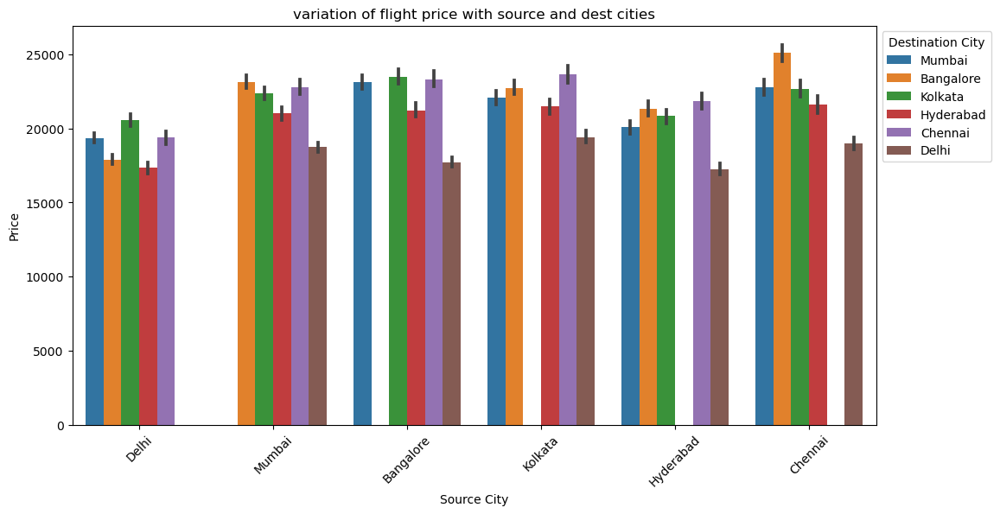

In [ ]:
plt.figure(figsize=(12, 6))
sns.barplot(x="source_city", y="price", hue="destination_city", data=df)
plt.xlabel("Source City")
plt.ylabel("Price")
plt.title("variation of flight price with source and dest cities")
plt.xticks(rotation=45)
plt.legend(title="Destination City", loc="upper left", bbox_to_anchor=(1, 1))
plt.show()


### e) How does the ticket price vary between Economy and Business class?



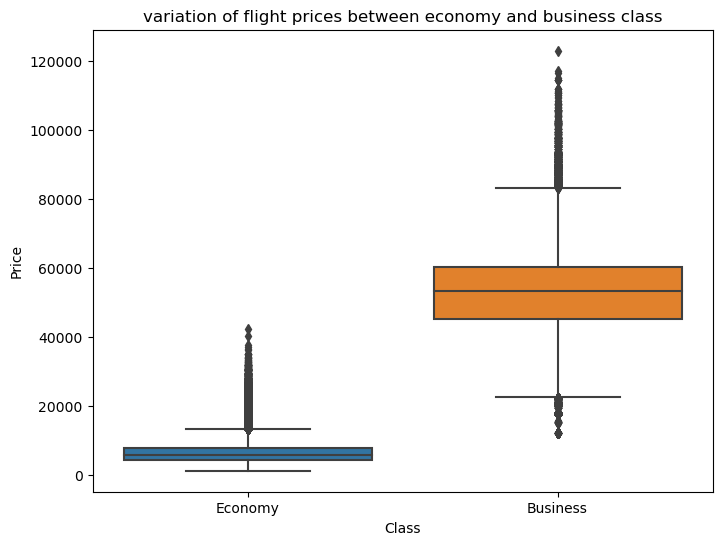

In [ ]:
plt.figure(figsize=(8, 6))
sns.boxplot(x="class", y="price", data=df)
plt.xlabel("Class")
plt.ylabel("Price")
plt.title("variation of flight prices between economy and business class")
plt.show()


#### from the above graph , we notice that economy flights are much cheaper than business flights , only some flights in this class exceeds 20000 (outliers).. business class flights start from 40000 to 60000 with some outliers under 20000 and above 80000.

In [ ]:
df.groupby('class')['price'].mean() # getting the same result without the above graph



class
Business    52540.081124
Economy      6572.342383
Name: price, dtype: float64

 ### F) What is the average ticket price for each airline?

In [ ]:
avg = df.groupby('airline')['price'].mean().sort_values(ascending=False)
avg

airline
Vistara      30396.536302
Air_India    23507.019112
SpiceJet      6179.278881
GO_FIRST      5652.007595
Indigo        5324.216303
AirAsia       4091.072742
Name: price, dtype: float64

### G) Is the ticket price affected by the number of stops between source and destination cities ?

In [ ]:
df.groupby('stops')['price'].mean()

stops
one            22900.992482
two_or_more    14113.450775
zero            9375.938535
Name: price, dtype: float64

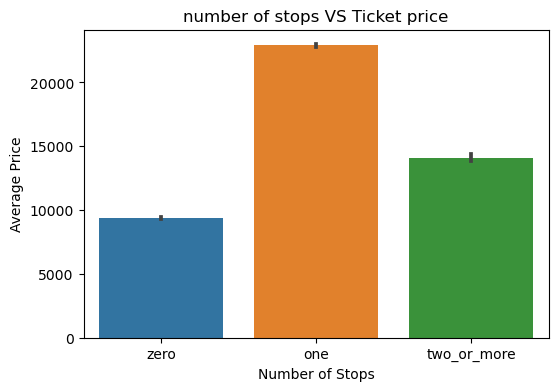

In [ ]:
### checking if we'll get the same resut using graph
plt.figure(figsize=(6, 4))
sns.barplot(x='stops', y='price', data=df)
plt.xlabel('Number of Stops')
plt.ylabel('Average Price')
plt.title('number of stops VS Ticket price')
plt.show()


#### from the above graph and the result before , we get that for zero stops , the flights price is cheaper than if there is two or more stops , and it's more expensive for one-stop flights.

### H) How many flights occur between Mumbai  and Delhi cities during the evening?

In [ ]:
df[(df['source_city'] == 'Mumbai') & (df['destination_city'] == 'Delhi') & (df['departure_time'] == 'Evening')]



,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price,duration_group,stops_group,days_left_group
43028,Vistara,UK-910,Mumbai,Evening,zero,Evening,Delhi,Economy,2.17,1,6048,2-4,0,0-1
43029,GO_FIRST,G8-339,Mumbai,Evening,zero,Night,Delhi,Economy,2.17,1,5942,2-4,0,0-1
43030,Indigo,6E-6004,Mumbai,Evening,zero,Night,Delhi,Economy,2.08,1,5943,2-4,0,0-1
43032,Air_India,AI-888,Mumbai,Evening,zero,Night,Delhi,Economy,2.25,1,5943,2-4,0,0-1
43034,Air_India,AI-660,Mumbai,Evening,zero,Night,Delhi,Economy,2.33,1,5943,2-4,0,0-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
229958,Vistara,UK-823,Mumbai,Evening,one,Night,Delhi,Business,6.08,49,51372,6-8,1,4+
229963,Vistara,UK-823,Mumbai,Evening,one,Morning,Delhi,Business,16.08,49,51372,8+,1,4+
229968,Vistara,UK-849,Mumbai,Evening,one,Night,Delhi,Business,6.25,49,53152,6-8,1,4+
229980,Air_India,AI-607,Mumbai,Evening,one,Night,Delhi,Business,7.17,49,53152,6-8,1,4+


### I) How many flights have at least one stop between the source and destination cities?

In [ ]:
s=df[df['stops'] !='zero']# or we can first replace caregorical values of stops with numbers then use >=1
s['stops'].value_counts()

one            250863
two_or_more     13286
Name: stops, dtype: int64

### J) If you're travelling from Delhi to Mumbai late at nighton a business class flight using Visatra Airlines , can you predict the price of ticket ?

In [ ]:
predict=df[(df['source_city']=='Mumbai')&(df['destination_city']=='Delhi')&(df['departure_time']=='Evening')&(df['class']=='Business')&(df['airline']=='Vistara')]
predict['price'].mean()

44945.167832167834

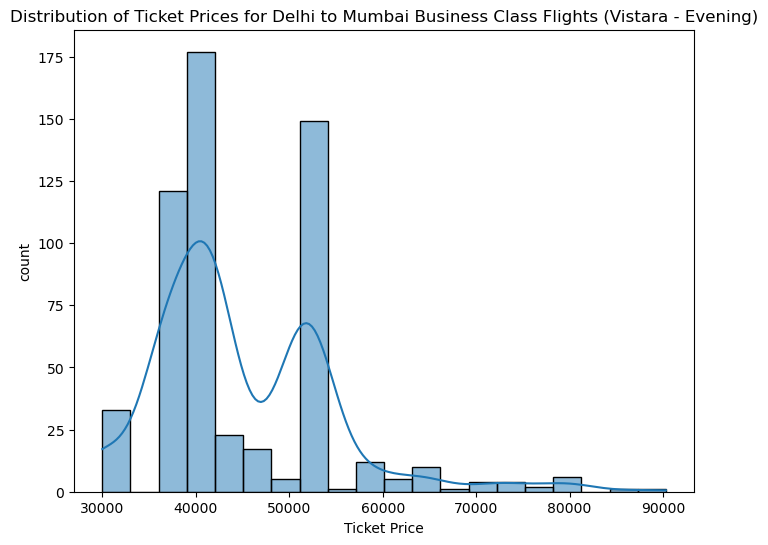

In [ ]:
# we can visualize that using a histogram " because the mean might not be the best approach"
plt.figure(figsize=(8, 6))
sns.histplot(data=predict, x='price', bins=20, kde=True)
plt.xlabel('Ticket Price')
plt.ylabel('count')
plt.title('Distribution of Ticket Prices for Delhi to Mumbai Business Class Flights (Vistara - Evening)')
plt.show()


In [ ]:
x=df[(df['stops'] == 'zero')& (df['duration'] <10 ) & (df['days_left']>47 )]
x

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price,duration_group,stops_group,days_left_group
9579,Vistara,UK-975,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.00,48,2476,0-2,0,4+
9580,Vistara,UK-953,Delhi,Night,zero,Night,Mumbai,Economy,2.17,48,2476,2-4,0,4+
9581,Vistara,UK-981,Delhi,Night,zero,Night,Mumbai,Economy,2.17,48,2476,2-4,0,4+
9582,Vistara,UK-927,Delhi,Morning,zero,Morning,Mumbai,Economy,2.08,48,2700,2-4,0,4+
9583,Vistara,UK-993,Delhi,Afternoon,zero,Afternoon,Mumbai,Economy,2.17,48,2700,2-4,0,4+
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293352,Vistara,UK-824,Chennai,Night,zero,Night,Mumbai,Business,2.08,49,23838,2-4,0,4+
297979,Air_India,AI-766,Chennai,Morning,zero,Afternoon,Kolkata,Business,2.58,48,20000,2-4,0,4+
298019,Air_India,AI-766,Chennai,Morning,zero,Afternoon,Kolkata,Business,2.58,49,20000,2-4,0,4+
300069,Air_India,AI-545,Chennai,Night,zero,Night,Hyderabad,Business,1.33,48,15000,0-2,0,4+


# Conclusion :

- In this flight price prediction analysis, I explored a dataset of flight booking options  and aimed to answer various research questions to gain meaningful insights for potential reservations . Here are the key findings:

- a) Does price vary with Airlines?
We observed that the ticket prices do vary with different airlines. Vistara Airlines tends to offer more expensive flights,Air india comes second, while SpiceJet, AirAsia, Go_first, and Indigo Airlines generally have similar price ranges.

- b) How is the price affected when tickets are bought in just 1 or 2 days before departure?
Tickets bought in just 1 or 2 days before departure are generally more expensive compared to flights with long days left before departure.

- c) Does ticket price change based on the departure time and arrival time?
The ticket price does vary based on the departure time and arrival time. Flights that take off late at night and in the afternoon tend to be cheaper, while evening flights are generally more expensive. For arrival times, evening flights are slightly more expensive than other times.

- d) How the price changes with the change in Source and Destination?
The flight price varies with the source and destination cities. The bar plot showed differences in ticket prices depending on the combination of source and destination cities, providing useful information for passengers planning their travel.

- e) How does the ticket price vary between Economy and Business class?
Business class flights are significantly more expensive than economy class flights. Economy class offers a more budget-friendly option, with only a few outliers having high prices, while business class flights generally start from higher price ranges.

- f) What is the average ticket price for each airline?
The average ticket price varies for different airlines, with Vistara Airlines having the highest average price, followed by Air India. SpiceJet, AirAsia, Go_first, and Indigo Airlines have relatively lower average prices.

- g) Is the ticket price affected by the number of stops between source and destination cities?
The ticket price is influenced by the number of stops. Flights with zero stops tend to be cheaper, while flights with one or more stops are generally more expensive.

- j) If you're traveling from Delhi to Mumbai late at night on a business class flight using Vistara Airlines, can you predict the price of the ticket?
For this specific scenario, the average price of the ticket for a business class flight from Delhi to Mumbai late at night using Vistara Airlines is approximately 44,945.17 . We also visualized the distribution of ticket prices using a histogram to better understand the spread of prices for this scenario.

##### In conclusion, this analysis provided valuable insights into the flight booking dataset and answered various research questions related to ticket prices, airlines, departure time, arrival time, stops, and class. These findings can help potential passengers make informed decisions about their travel plans based on the factors that influence ticket prices.

##   <font color='red'>Thanks for reading :) </font>
